### Import libraries

In [1]:
import numpy as np
import pandas as pd
import datetime
import matplotlib.pyplot as plt; plt.rcdefaults()
import seaborn as sns
%matplotlib inline
import plotly.express as px

## Data Cleaning and Preprocessing

### Read power generation and weather data datasets 

In [2]:
data_gen1 = pd.read_csv('Plant_1_Generation_Data.csv')
data_gen1['DATE_TIME'] = pd.to_datetime(data_gen1['DATE_TIME'], format='%d-%m-%Y %H:%M').dt.strftime('%Y-%m-%d %H:%M')
data_gen1.tail()

,DATE_TIME,PLANT_ID,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
68773,2020-06-17 23:45,4135001,uHbuxQJl8lW7ozc,0.0,0.0,5967.000,7287002.0
68774,2020-06-17 23:45,4135001,wCURE6d3bPkepu2,0.0,0.0,5147.625,7028601.0
68775,2020-06-17 23:45,4135001,z9Y9gH1T5YWrNuG,0.0,0.0,5819.000,7251204.0
68776,2020-06-17 23:45,4135001,zBIq5rxdHJRwDNY,0.0,0.0,5817.000,6583369.0
68777,2020-06-17 23:45,4135001,zVJPv84UY57bAof,0.0,0.0,5910.000,7363272.0


In [3]:
data_gen2 = pd.read_csv('Plant_2_Generation_Data.csv')
data_gen2.tail()

,DATE_TIME,PLANT_ID,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
67693,2020-06-17 23:45:00,4136001,q49J1IKaHRwDQnt,0.0,0.0,4157.0,520758.0
67694,2020-06-17 23:45:00,4136001,rrq4fwE8jgrTyWY,0.0,0.0,3931.0,121131356.0
67695,2020-06-17 23:45:00,4136001,vOuJvMaM2sgwLmb,0.0,0.0,4322.0,2427691.0
67696,2020-06-17 23:45:00,4136001,xMbIugepa2P7lBB,0.0,0.0,4218.0,106896394.0
67697,2020-06-17 23:45:00,4136001,xoJJ8DcxJEcupym,0.0,0.0,4316.0,209335741.0


In [4]:
data_sens1 = pd.read_csv('Plant_1_Weather_Sensor_Data.csv')
data_sens1.tail()

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
3177,2020-06-17 22:45:00,4135001,HmiyD2TTLFNqkNe,22.150570,21.480377,0.0
3178,2020-06-17 23:00:00,4135001,HmiyD2TTLFNqkNe,22.129816,21.389024,0.0
3179,2020-06-17 23:15:00,4135001,HmiyD2TTLFNqkNe,22.008275,20.709211,0.0
3180,2020-06-17 23:30:00,4135001,HmiyD2TTLFNqkNe,21.969495,20.734963,0.0
3181,2020-06-17 23:45:00,4135001,HmiyD2TTLFNqkNe,21.909288,20.427972,0.0


In [5]:
data_sens2 = pd.read_csv('Plant_2_Weather_Sensor_Data.csv')
data_sens2.tail()

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
3254,2020-06-17 22:45:00,4136001,iq8k7ZNt4Mwm3w0,23.511703,22.856201,0.0
3255,2020-06-17 23:00:00,4136001,iq8k7ZNt4Mwm3w0,23.482282,22.744190,0.0
3256,2020-06-17 23:15:00,4136001,iq8k7ZNt4Mwm3w0,23.354743,22.492245,0.0
3257,2020-06-17 23:30:00,4136001,iq8k7ZNt4Mwm3w0,23.291048,22.373909,0.0
3258,2020-06-17 23:45:00,4136001,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0


### Print invertors and plant id's

In [6]:
print(data_gen1['SOURCE_KEY'].unique())
print(data_gen2['SOURCE_KEY'].unique())
print(data_sens1['SOURCE_KEY'].unique())
print(data_sens2['SOURCE_KEY'].unique())
print(data_gen1["PLANT_ID"].unique())
print(data_gen2["PLANT_ID"].unique())

['1BY6WEcLGh8j5v7' '1IF53ai7Xc0U56Y' '3PZuoBAID5Wc2HD' '7JYdWkrLSPkdwr4'
 'McdE0feGgRqW7Ca' 'VHMLBKoKgIrUVDU' 'WRmjgnKYAwPKWDb' 'ZnxXDlPa8U1GXgE'
 'ZoEaEvLYb1n2sOq' 'adLQvlD726eNBSB' 'bvBOhCH3iADSZry' 'iCRJl6heRkivqQ3'
 'ih0vzX44oOqAx2f' 'pkci93gMrogZuBj' 'rGa61gmuvPhdLxV' 'sjndEbLyjtCKgGv'
 'uHbuxQJl8lW7ozc' 'wCURE6d3bPkepu2' 'z9Y9gH1T5YWrNuG' 'zBIq5rxdHJRwDNY'
 'zVJPv84UY57bAof' 'YxYtjZvoooNbGkE']
['4UPUqMRk7TRMgml' '81aHJ1q11NBPMrL' '9kRcWv60rDACzjR' 'Et9kgGMDl729KT4'
 'IQ2d7wF4YD8zU1Q' 'LYwnQax7tkwH5Cb' 'LlT2YUhhzqhg5Sw' 'Mx2yZCDsyf6DPfv'
 'NgDl19wMapZy17u' 'PeE6FRyGXUgsRhN' 'Qf4GUc1pJu5T6c6' 'Quc1TzYxW2pYoWX'
 'V94E5Ben1TlhnDV' 'WcxssY2VbP4hApt' 'mqwcsP2rE7J0TFp' 'oZ35aAeoifZaQzV'
 'oZZkBaNadn6DNKz' 'q49J1IKaHRwDQnt' 'rrq4fwE8jgrTyWY' 'vOuJvMaM2sgwLmb'
 'xMbIugepa2P7lBB' 'xoJJ8DcxJEcupym']
['HmiyD2TTLFNqkNe']
['iq8k7ZNt4Mwm3w0']
[4135001]
[4136001]


### How many invertors in Plant1?

In [7]:
unique_gen1 = data_gen1["SOURCE_KEY"].nunique()
print(unique_gen1)

22


### Change date format power generation dataset from Y-M-D H-M to Y-M-D H-M-S

In [8]:
data_gen1['DATE_TIME'] = pd.to_datetime(data_gen1['DATE_TIME'],format = '%Y-%m-%d %H:%M')
data_sens1['DATE_TIME'] = pd.to_datetime(data_sens1['DATE_TIME'],format = '%Y-%m-%d %H:%M:%S')

### Merge weather and power generation data for plant1 and rename columns 

In [9]:
data_plant1 = pd.merge(data_gen1.rename(columns = {'SOURCE_KEY':'SK_INVERTERS'}, inplace = False), data_sens1.drop(columns = ['PLANT_ID']), on='DATE_TIME')
data_plant1.rename(columns = {'SOURCE_KEY':'SK_SENSORS'}, inplace = True)

### Introduce efficiency based on Daily Yield.

In [10]:
data_plant1['EFFICIENCY'] = np.where(data_plant1['DAILY_YIELD'] >= 4280, 'H', 'L')
data_plant1.tail(5)

,DATE_TIME,PLANT_ID,SK_INVERTERS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,SK_SENSORS,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,EFFICIENCY
68769,2020-06-17 23:45:00,4135001,uHbuxQJl8lW7ozc,0.0,0.0,5967.000,7287002.0,HmiyD2TTLFNqkNe,21.909288,20.427972,0.0,H
68770,2020-06-17 23:45:00,4135001,wCURE6d3bPkepu2,0.0,0.0,5147.625,7028601.0,HmiyD2TTLFNqkNe,21.909288,20.427972,0.0,H
68771,2020-06-17 23:45:00,4135001,z9Y9gH1T5YWrNuG,0.0,0.0,5819.000,7251204.0,HmiyD2TTLFNqkNe,21.909288,20.427972,0.0,H
68772,2020-06-17 23:45:00,4135001,zBIq5rxdHJRwDNY,0.0,0.0,5817.000,6583369.0,HmiyD2TTLFNqkNe,21.909288,20.427972,0.0,H
68773,2020-06-17 23:45:00,4135001,zVJPv84UY57bAof,0.0,0.0,5910.000,7363272.0,HmiyD2TTLFNqkNe,21.909288,20.427972,0.0,H


### Calculate the number of rows for combined dataset1 

In [11]:
data_plant1['PLANT_ID'].value_counts()

4135001    68774
Name: PLANT_ID, dtype: int64

### Apply the same manipulations to generate combined dataset for plant2

In [12]:
data_gen2['DATE_TIME'] = pd.to_datetime(data_gen2['DATE_TIME'],format = '%Y-%m-%d %H:%M')
data_sens2['DATE_TIME'] = pd.to_datetime(data_sens2['DATE_TIME'],format = '%Y-%m-%d %H:%M:%S')
data_plant2 = pd.merge(data_gen2.rename(columns = {'SOURCE_KEY':'SK_INVERTERS'}, inplace = False), data_sens2.drop(columns = ['PLANT_ID']), on='DATE_TIME')
data_plant2.rename(columns = {'SOURCE_KEY':'SK_SENSORS'}, inplace = True)
data_plant2['EFFICIENCY'] = np.where(data_plant2['DAILY_YIELD'] >= 4280, 'H', 'L')
data_plant2.tail()

,DATE_TIME,PLANT_ID,SK_INVERTERS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,SK_SENSORS,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,EFFICIENCY
67693,2020-06-17 23:45:00,4136001,q49J1IKaHRwDQnt,0.0,0.0,4157.0,520758.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,L
67694,2020-06-17 23:45:00,4136001,rrq4fwE8jgrTyWY,0.0,0.0,3931.0,121131356.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,L
67695,2020-06-17 23:45:00,4136001,vOuJvMaM2sgwLmb,0.0,0.0,4322.0,2427691.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,H
67696,2020-06-17 23:45:00,4136001,xMbIugepa2P7lBB,0.0,0.0,4218.0,106896394.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,L
67697,2020-06-17 23:45:00,4136001,xoJJ8DcxJEcupym,0.0,0.0,4316.0,209335741.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,H


### Calculate the number of rows for combined dataset2 

In [13]:
data_plant2['PLANT_ID'].value_counts()

4136001    67698
Name: PLANT_ID, dtype: int64

### Concatinate 2 datasets together into one combined dataset

In [14]:
#df_ALL = data_plant1.append(data_plant2, ignore_index=True)
df_ALL = pd.concat([data_plant1, data_plant2], ignore_index=True)
df_ALL.tail() 

,DATE_TIME,PLANT_ID,SK_INVERTERS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,SK_SENSORS,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,EFFICIENCY
136467,2020-06-17 23:45:00,4136001,q49J1IKaHRwDQnt,0.0,0.0,4157.0,520758.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,L
136468,2020-06-17 23:45:00,4136001,rrq4fwE8jgrTyWY,0.0,0.0,3931.0,121131356.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,L
136469,2020-06-17 23:45:00,4136001,vOuJvMaM2sgwLmb,0.0,0.0,4322.0,2427691.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,H
136470,2020-06-17 23:45:00,4136001,xMbIugepa2P7lBB,0.0,0.0,4218.0,106896394.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,L
136471,2020-06-17 23:45:00,4136001,xoJJ8DcxJEcupym,0.0,0.0,4316.0,209335741.0,iq8k7ZNt4Mwm3w0,23.202871,22.535908,0.0,H


### Look at the shape and info of combined dataset

In [15]:
df_ALL.shape


(136472, 12)

In [16]:
df_ALL.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136472 entries, 0 to 136471
Data columns (total 12 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   DATE_TIME            136472 non-null  datetime64[ns]
 1   PLANT_ID             136472 non-null  int64         
 2   SK_INVERTERS         136472 non-null  object        
 3   DC_POWER             136472 non-null  float64       
 4   AC_POWER             136472 non-null  float64       
 5   DAILY_YIELD          136472 non-null  float64       
 6   TOTAL_YIELD          136472 non-null  float64       
 7   SK_SENSORS           136472 non-null  object        
 8   AMBIENT_TEMPERATURE  136472 non-null  float64       
 9   MODULE_TEMPERATURE   136472 non-null  float64       
 10  IRRADIATION          136472 non-null  float64       
 11  EFFICIENCY           136472 non-null  object        
dtypes: datetime64[ns](1), float64(7), int64(1), object(3)
memory usage: 12.5

In [17]:
print(data_plant1['PLANT_ID'].value_counts())
print(data_plant2['PLANT_ID'].value_counts())

4135001    68774
Name: PLANT_ID, dtype: int64
4136001    67698
Name: PLANT_ID, dtype: int64


### Re-arrange columns for cobined dataframe

In [18]:
df_ALL = df_ALL[['DATE_TIME', 'SK_INVERTERS', 'SK_SENSORS','DC_POWER', 'AC_POWER',
       'DAILY_YIELD', 'TOTAL_YIELD', 'AMBIENT_TEMPERATURE',
       'MODULE_TEMPERATURE', 'IRRADIATION', 'PLANT_ID', 'EFFICIENCY']]
df_ALL.head(10)   

,DATE_TIME,SK_INVERTERS,SK_SENSORS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,PLANT_ID,EFFICIENCY
0,2020-05-15,1BY6WEcLGh8j5v7,HmiyD2TTLFNqkNe,0.0,0.0,0.0,6259559.0,25.184316,22.857507,0.0,4135001,L
1,2020-05-15,1IF53ai7Xc0U56Y,HmiyD2TTLFNqkNe,0.0,0.0,0.0,6183645.0,25.184316,22.857507,0.0,4135001,L
2,2020-05-15,3PZuoBAID5Wc2HD,HmiyD2TTLFNqkNe,0.0,0.0,0.0,6987759.0,25.184316,22.857507,0.0,4135001,L
3,2020-05-15,7JYdWkrLSPkdwr4,HmiyD2TTLFNqkNe,0.0,0.0,0.0,7602960.0,25.184316,22.857507,0.0,4135001,L
4,2020-05-15,McdE0feGgRqW7Ca,HmiyD2TTLFNqkNe,0.0,0.0,0.0,7158964.0,25.184316,22.857507,0.0,4135001,L
5,2020-05-15,VHMLBKoKgIrUVDU,HmiyD2TTLFNqkNe,0.0,0.0,0.0,7206408.0,25.184316,22.857507,0.0,4135001,L
6,2020-05-15,WRmjgnKYAwPKWDb,HmiyD2TTLFNqkNe,0.0,0.0,0.0,7028673.0,25.184316,22.857507,0.0,4135001,L
7,2020-05-15,ZnxXDlPa8U1GXgE,HmiyD2TTLFNqkNe,0.0,0.0,0.0,6522172.0,25.184316,22.857507,0.0,4135001,L
8,2020-05-15,ZoEaEvLYb1n2sOq,HmiyD2TTLFNqkNe,0.0,0.0,0.0,7098099.0,25.184316,22.857507,0.0,4135001,L
9,2020-05-15,adLQvlD726eNBSB,HmiyD2TTLFNqkNe,0.0,0.0,0.0,6271355.0,25.184316,22.857507,0.0,4135001,L


### Replace Plant ID's with single labels - Plant1 and Plant2

In [19]:
df_ALL['PLANT_ID'] = df_ALL['PLANT_ID'].replace([4135001],'Plant1')
df_ALL['PLANT_ID'] = df_ALL['PLANT_ID'].replace([4136001],'Plant2')
df_ALL.tail()

,DATE_TIME,SK_INVERTERS,SK_SENSORS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,PLANT_ID,EFFICIENCY
136467,2020-06-17 23:45:00,q49J1IKaHRwDQnt,iq8k7ZNt4Mwm3w0,0.0,0.0,4157.0,520758.0,23.202871,22.535908,0.0,Plant2,L
136468,2020-06-17 23:45:00,rrq4fwE8jgrTyWY,iq8k7ZNt4Mwm3w0,0.0,0.0,3931.0,121131356.0,23.202871,22.535908,0.0,Plant2,L
136469,2020-06-17 23:45:00,vOuJvMaM2sgwLmb,iq8k7ZNt4Mwm3w0,0.0,0.0,4322.0,2427691.0,23.202871,22.535908,0.0,Plant2,H
136470,2020-06-17 23:45:00,xMbIugepa2P7lBB,iq8k7ZNt4Mwm3w0,0.0,0.0,4218.0,106896394.0,23.202871,22.535908,0.0,Plant2,L
136471,2020-06-17 23:45:00,xoJJ8DcxJEcupym,iq8k7ZNt4Mwm3w0,0.0,0.0,4316.0,209335741.0,23.202871,22.535908,0.0,Plant2,H


### Check in which column we have null values

In [20]:
print(0.0 in df_ALL['DATE_TIME'].values)
print(0.0 in df_ALL['SK_INVERTERS'].values)
print(0.0 in df_ALL['DC_POWER'].values)
print(0.0 in df_ALL['AC_POWER'].values)
print(0.0 in df_ALL['DAILY_YIELD'].values)
print(0.0 in df_ALL['TOTAL_YIELD'].values)
print(0.0 in df_ALL['AMBIENT_TEMPERATURE'].values)
print(0.0 in df_ALL['MODULE_TEMPERATURE'].values)
print(0.0 in df_ALL['IRRADIATION'].values)
print(0.0 in df_ALL['PLANT_ID'].values)
print(0.0 in df_ALL['EFFICIENCY'].values)

False
False
True
True
True
True
False
False
True
False
False


<ipython-input-20-e2e9d27a9f8d>:1: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  print(0.0 in df_ALL['DATE_TIME'].values)


### Look at the description of combined dataframe

In [21]:
df_ALL.describe()

,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
count,136472.000000,136472.000000,136472.000000,1.364720e+05,136472.000000,136472.000000,136472.000000
mean,1708.373962,274.790259,3295.366192,3.303916e+08,26.763066,31.920744,0.230767
std,3222.079306,380.180214,3035.313217,6.085769e+08,3.897340,11.803674,0.305652
min,0.000000,0.000000,0.000000,0.000000e+00,20.398505,18.140415,0.000000
25%,0.000000,0.000000,28.285714,6.520020e+06,23.637604,22.411698,0.000000
50%,5.993333,3.493095,2834.642857,7.269333e+06,25.908122,26.413755,0.026213
75%,1155.595000,532.568571,5992.000000,2.826096e+08,29.266583,40.778583,0.442961
max,14471.125000,1410.950000,9873.000000,2.247916e+09,39.181638,66.635953,1.221652


### Make a final check for our transformed dataset

In [22]:
df_ALL.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136472 entries, 0 to 136471
Data columns (total 12 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   DATE_TIME            136472 non-null  datetime64[ns]
 1   SK_INVERTERS         136472 non-null  object        
 2   SK_SENSORS           136472 non-null  object        
 3   DC_POWER             136472 non-null  float64       
 4   AC_POWER             136472 non-null  float64       
 5   DAILY_YIELD          136472 non-null  float64       
 6   TOTAL_YIELD          136472 non-null  float64       
 7   AMBIENT_TEMPERATURE  136472 non-null  float64       
 8   MODULE_TEMPERATURE   136472 non-null  float64       
 9   IRRADIATION          136472 non-null  float64       
 10  PLANT_ID             136472 non-null  object        
 11  EFFICIENCY           136472 non-null  object        
dtypes: datetime64[ns](1), float64(7), object(4)
memory usage: 12.5+ MB


In [23]:
df_ALL.shape

(136472, 12)

In [24]:
df_ALL.columns

Index(['DATE_TIME', 'SK_INVERTERS', 'SK_SENSORS', 'DC_POWER', 'AC_POWER',
       'DAILY_YIELD', 'TOTAL_YIELD', 'AMBIENT_TEMPERATURE',
       'MODULE_TEMPERATURE', 'IRRADIATION', 'PLANT_ID', 'EFFICIENCY'],
      dtype='object')

## Feature Engineering

### Defining Features and Labels


In [25]:
feature_names = ["DATE_TIME", "SK_INVERTERS", "SK_SENSORS",	"DC_POWER",	"AC_POWER",	"DAILY_YIELD", "TOTAL_YIELD",	"AMBIENT_TEMPERATURE",	
                    "MODULE_TEMPERATURE",	"IRRADIATION", "PLANT_ID"]
label_name = "EFFICIENCY"
column_names = feature_names + [label_name]

### Check the total number of features  

In [26]:
n = len(df_ALL)
m = len(df_ALL.columns) - 1

print("Number of Examples:", n)
print("Number Features:", m)

Number of Examples: 136472
Number Features: 11


### Split Numeric and non_numeric_features

In [27]:
df_nozero = df_ALL[(df_ALL[feature_names] != 0).all(axis=1)]

non_numeric_features = ["DATE_TIME", "SK_INVERTERS", "SK_SENSORS", "PLANT_ID", "EFFICIENCY"	]
numeric_features = ["DC_POWER",	"AC_POWER",	"DAILY_YIELD", "TOTAL_YIELD",	"AMBIENT_TEMPERATURE",	
                    "MODULE_TEMPERATURE",	"IRRADIATION"]

df_numeric = df_nozero[numeric_features]
df_nozero.head()

,DATE_TIME,SK_INVERTERS,SK_SENSORS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,PLANT_ID,EFFICIENCY
531,2020-05-15 06:15:00,1BY6WEcLGh8j5v7,HmiyD2TTLFNqkNe,278.000000,26.862500,2.625000,6259561.625,24.011635,22.353459,0.022282,Plant1,L
532,2020-05-15 06:15:00,1IF53ai7Xc0U56Y,HmiyD2TTLFNqkNe,310.571429,30.014286,3.000000,6183648.000,24.011635,22.353459,0.022282,Plant1,L
533,2020-05-15 06:15:00,3PZuoBAID5Wc2HD,HmiyD2TTLFNqkNe,318.625000,30.775000,3.500000,6987762.500,24.011635,22.353459,0.022282,Plant1,L
534,2020-05-15 06:15:00,7JYdWkrLSPkdwr4,HmiyD2TTLFNqkNe,316.250000,30.562500,3.500000,7602963.500,24.011635,22.353459,0.022282,Plant1,L
535,2020-05-15 06:15:00,McdE0feGgRqW7Ca,HmiyD2TTLFNqkNe,311.428571,30.100000,3.142857,7158967.143,24.011635,22.353459,0.022282,Plant1,L


## Data Visualization

### Create Combined Power Generation Data Correlation Using Heatmap

In [28]:
df_ALL_cor_features = np.array([
       'DC_POWER', 'AC_POWER',
       'DAILY_YIELD', 'TOTAL_YIELD', 'AMBIENT_TEMPERATURE',
       'MODULE_TEMPERATURE', 'IRRADIATION'])


In [29]:
df_nozero.dtypes

DATE_TIME              datetime64[ns]
SK_INVERTERS                   object
SK_SENSORS                     object
DC_POWER                      float64
AC_POWER                      float64
DAILY_YIELD                   float64
TOTAL_YIELD                   float64
AMBIENT_TEMPERATURE           float64
MODULE_TEMPERATURE            float64
IRRADIATION                   float64
PLANT_ID                       object
EFFICIENCY                     object
dtype: object

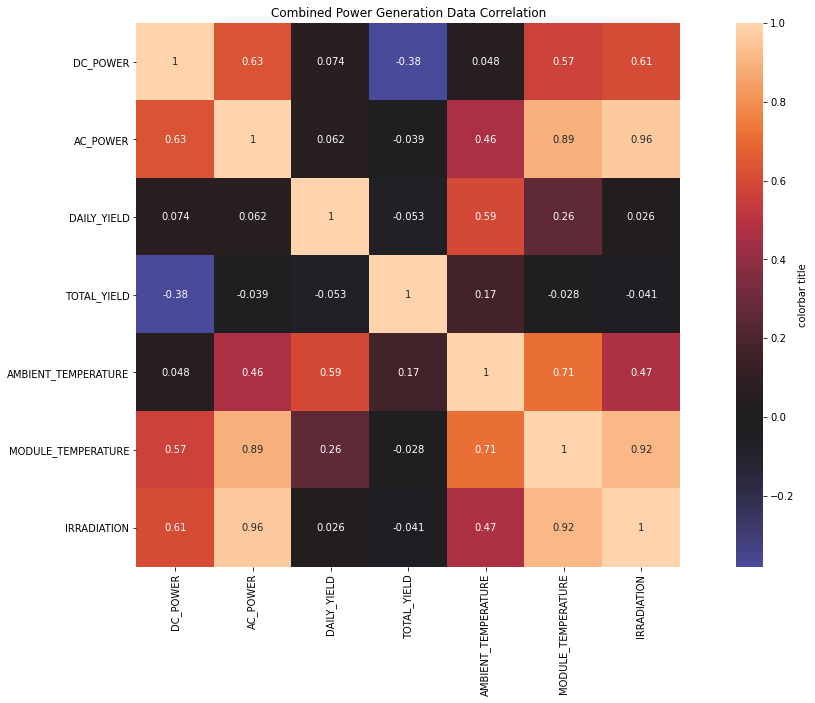

In [30]:
plt.figure(figsize=(20,10))
sns.heatmap(df_nozero.corr(), annot=True, center=0, square=True, cbar_kws={'label': 'colorbar title'})
plt.title('Combined Power Generation Data Correlation')
plt.show()

### Visualize numeric features with effeciency as a label using histogram

In [31]:
for feature in numeric_features:
  fig = px.histogram(df_nozero, x=feature, color=label_name)
  fig.show()

### Visualize weather data using line plots

<ipython-input-32-2bc3f52b0f2f>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



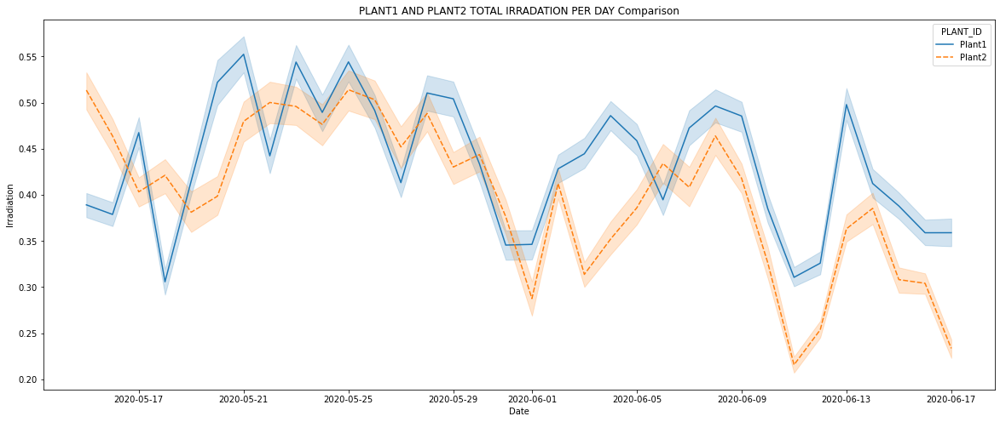

In [32]:
df_nozero['date'] = pd.to_datetime(df_nozero['DATE_TIME']).dt.date
ax = sns.lineplot(data=df_nozero, x='date', y="IRRADIATION", hue="PLANT_ID", style="PLANT_ID")
fig = plt.gcf()
fig.set_size_inches(20, 8)
ax.set(xlabel='Date', ylabel='Irradiation')
plt.title('PLANT1 AND PLANT2 TOTAL IRRADATION PER DAY Comparison')
plt.show()

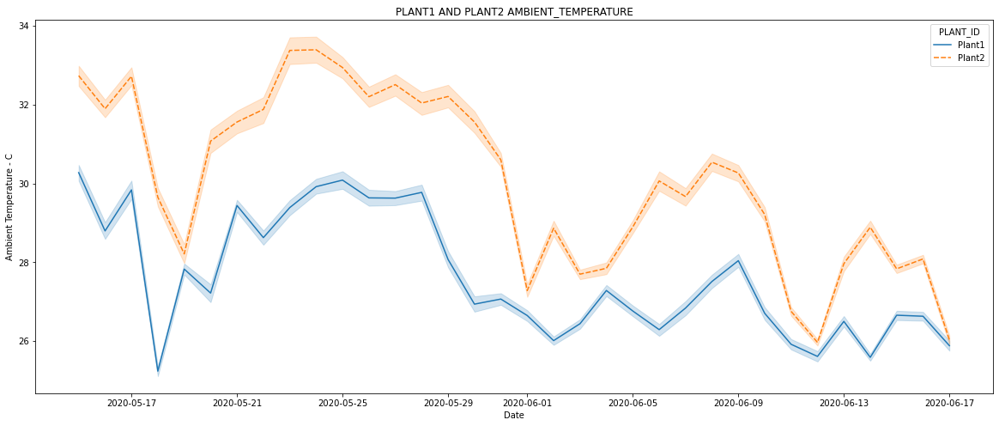

In [33]:
ax = sns.lineplot(data=df_nozero, x='date', y="AMBIENT_TEMPERATURE", hue="PLANT_ID", style="PLANT_ID")
fig = plt.gcf()
fig.set_size_inches(20, 8)
ax.set(xlabel='Date', ylabel='Ambient Temperature - C')
plt.title('PLANT1 AND PLANT2 AMBIENT_TEMPERATURE')
plt.show()

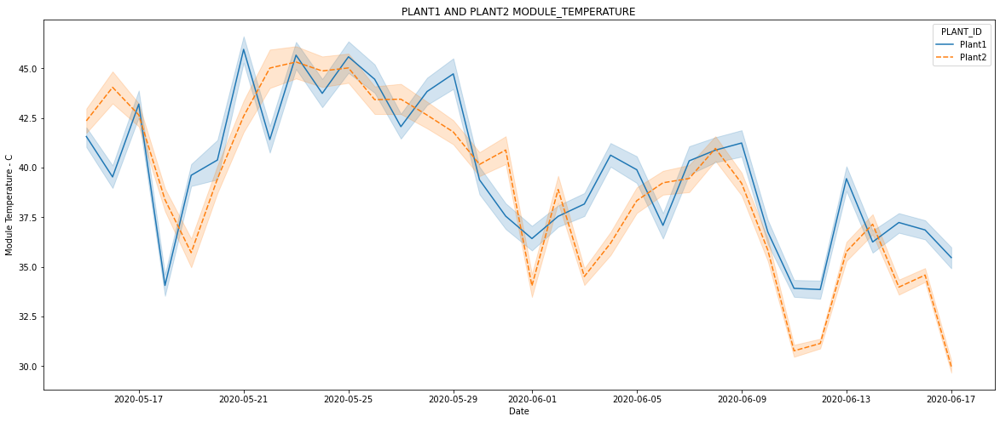

In [34]:
ax = sns.lineplot(data=df_nozero, x='date', y="MODULE_TEMPERATURE", hue="PLANT_ID", style="PLANT_ID")
fig = plt.gcf()
fig.set_size_inches(20, 8)
ax.set(xlabel='Date', ylabel='Module Temperature - C')
plt.title('PLANT1 AND PLANT2 MODULE_TEMPERATURE')
plt.show()

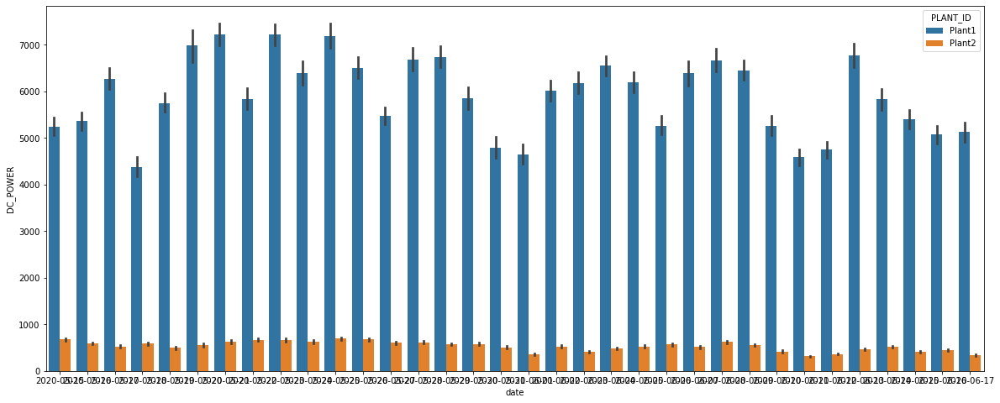

In [35]:
sns.barplot(x = df_nozero.date, y = df_nozero.DC_POWER, hue = df_nozero.PLANT_ID)
fig = plt.gcf()
fig.set_size_inches(20, 8)

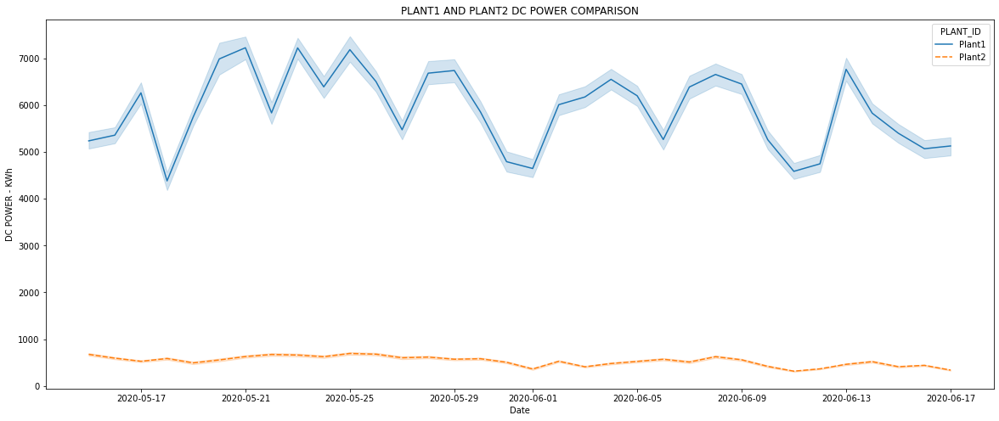

In [36]:
ax = sns.lineplot(data=df_nozero, x='date', y="DC_POWER", hue="PLANT_ID", style="PLANT_ID")
fig = plt.gcf()
fig.set_size_inches(20, 8)
ax.set(xlabel='Date', ylabel='DC POWER - KWh')
plt.title('PLANT1 AND PLANT2 DC POWER COMPARISON')
plt.show()

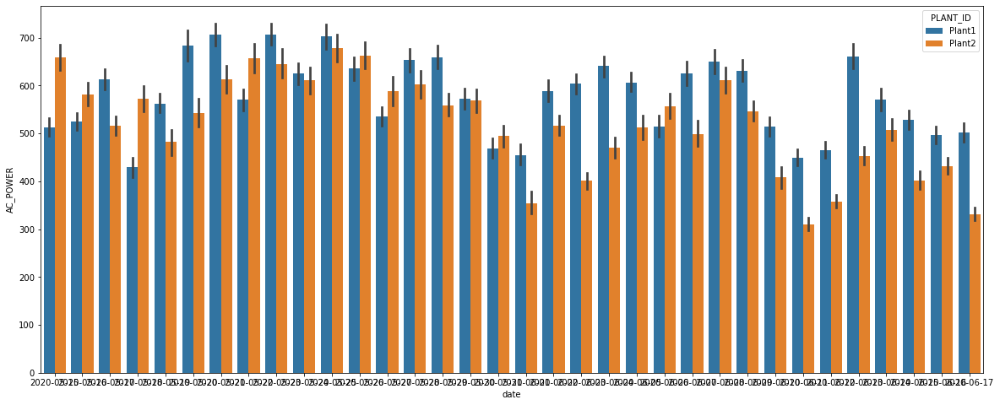

In [37]:
sns.barplot(x = df_nozero.date, y = df_nozero.AC_POWER, hue = df_nozero.PLANT_ID)
fig = plt.gcf()
fig.set_size_inches(20, 8)

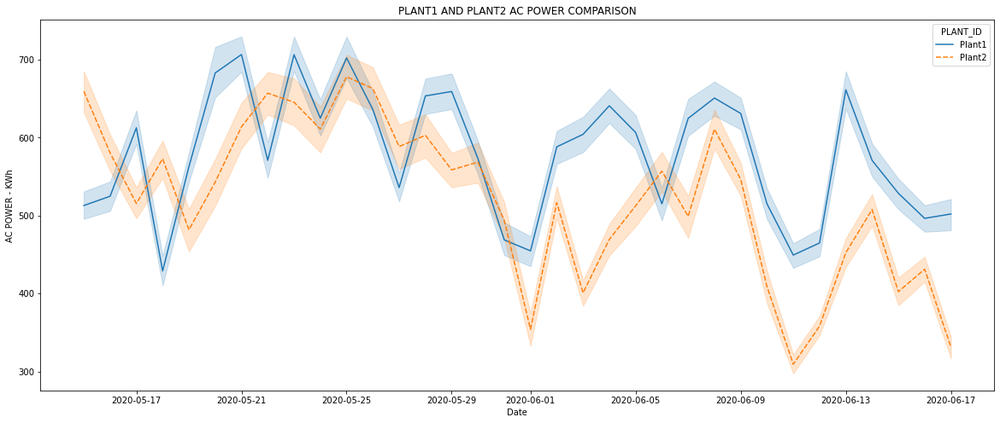

In [38]:
ax = sns.lineplot(data=df_nozero, x='date', y="AC_POWER", hue="PLANT_ID", style="PLANT_ID")
fig = plt.gcf()
fig.set_size_inches(20, 8)
ax.set(xlabel='Date', ylabel='AC POWER - KWh')
plt.title('PLANT1 AND PLANT2 AC POWER COMPARISON')
plt.show()

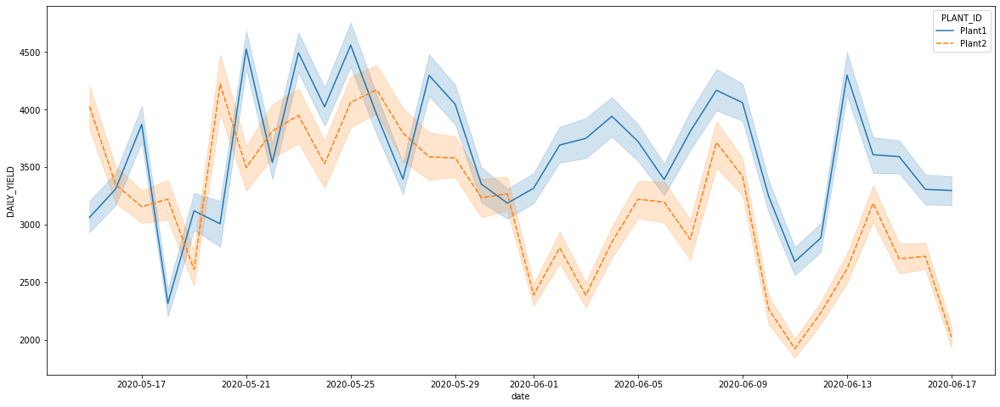

In [39]:
sns.lineplot(data=df_nozero, x='date', y="DAILY_YIELD", hue="PLANT_ID", style="PLANT_ID")
fig = plt.gcf()
fig.set_size_inches(20, 8)

In [40]:
df_nozero.head()

,DATE_TIME,SK_INVERTERS,SK_SENSORS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,PLANT_ID,EFFICIENCY,date
531,2020-05-15 06:15:00,1BY6WEcLGh8j5v7,HmiyD2TTLFNqkNe,278.000000,26.862500,2.625000,6259561.625,24.011635,22.353459,0.022282,Plant1,L,2020-05-15
532,2020-05-15 06:15:00,1IF53ai7Xc0U56Y,HmiyD2TTLFNqkNe,310.571429,30.014286,3.000000,6183648.000,24.011635,22.353459,0.022282,Plant1,L,2020-05-15
533,2020-05-15 06:15:00,3PZuoBAID5Wc2HD,HmiyD2TTLFNqkNe,318.625000,30.775000,3.500000,6987762.500,24.011635,22.353459,0.022282,Plant1,L,2020-05-15
534,2020-05-15 06:15:00,7JYdWkrLSPkdwr4,HmiyD2TTLFNqkNe,316.250000,30.562500,3.500000,7602963.500,24.011635,22.353459,0.022282,Plant1,L,2020-05-15
535,2020-05-15 06:15:00,McdE0feGgRqW7Ca,HmiyD2TTLFNqkNe,311.428571,30.100000,3.142857,7158967.143,24.011635,22.353459,0.022282,Plant1,L,2020-05-15


In [41]:
def inverter_total_yield(data, label=''):
    pd.options.display.float_format = '{:.2f}'.format
    tmp = data.groupby(['SK_INVERTERS']).agg({'DAILY_YIELD':'max'}).reset_index().sort_values(['DAILY_YIELD'], ascending=False).reset_index(drop=True)
    print(tmp)
    
    return tmp  

In [42]:
def ranking_total_yield():
    print('TOTAL_YIELD - PLANT 1')
    total_yield1 = inverter_total_yield(data_plant1)
    print('')
    print('TOTAL_YIELD - PLANT 2')
    total_yield2 = inverter_total_yield(data_plant2)
    
    return total_yield1, total_yield2
    
total_yield1, total_yield2 = ranking_total_yield()

TOTAL_YIELD - PLANT 1
       SK_INVERTERS  DAILY_YIELD
0   adLQvlD726eNBSB      9163.00
1   3PZuoBAID5Wc2HD      9068.00
2   1IF53ai7Xc0U56Y      9048.00
3   VHMLBKoKgIrUVDU      9013.00
4   McdE0feGgRqW7Ca      8964.00
5   uHbuxQJl8lW7ozc      8913.00
6   ZnxXDlPa8U1GXgE      8910.00
7   wCURE6d3bPkepu2      8895.00
8   zBIq5rxdHJRwDNY      8891.00
9   iCRJl6heRkivqQ3      8887.00
10  WRmjgnKYAwPKWDb      8879.00
11  pkci93gMrogZuBj      8849.00
12  zVJPv84UY57bAof      8842.00
13  rGa61gmuvPhdLxV      8821.00
14  YxYtjZvoooNbGkE      8818.00
15  z9Y9gH1T5YWrNuG      8802.00
16  7JYdWkrLSPkdwr4      8779.00
17  sjndEbLyjtCKgGv      8777.00
18  ZoEaEvLYb1n2sOq      8745.00
19  ih0vzX44oOqAx2f      8664.00
20  1BY6WEcLGh8j5v7      8268.00
21  bvBOhCH3iADSZry      8131.00

TOTAL_YIELD - PLANT 2
       SK_INVERTERS  DAILY_YIELD
0   Qf4GUc1pJu5T6c6      9873.00
1   oZ35aAeoifZaQzV      9866.00
2   4UPUqMRk7TRMgml      9863.00
3   Mx2yZCDsyf6DPfv      9801.00
4   oZZkBaNadn6DNKz      9729.0

In [43]:
df_ALL.isnull().sum()

DATE_TIME              0
SK_INVERTERS           0
SK_SENSORS             0
DC_POWER               0
AC_POWER               0
DAILY_YIELD            0
TOTAL_YIELD            0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
PLANT_ID               0
EFFICIENCY             0
dtype: int64

In [44]:
print(0.0 in df_ALL.values)
print(0.0 in df_nozero.values)

True
False


In [45]:
df_ALL['PLANT_ID'].value_counts()

Plant1    68774
Plant2    67698
Name: PLANT_ID, dtype: int64

**Let us compare DC/AC ratio for plant1 and Plant2. Plant1's DC/AC ratio is 10 times greater then Plant2. It may make sense to divide Plant1 DC_POWER by 10.**

In [113]:
def ratio(dat):
    tmp = data.sum()
    return round(tmp['DC_POWER'] / tmp['AC_POWER'] * 100, 2)

df1_tmp = data_plant1.copy()
df1_tmp['DC_POWER'] /= 10

print(f"Plant2 DC/AC Ratio : {ratio(data_plant2)}%")
print(f"Plant1 DC/AC Ratio : {ratio(data_plant1)}%")
print(f"Plant1 DC/AC Ratio divided by 10: {ratio(df1_tmp)}%")

NameError: name 'data' is not defined

In [47]:
df_All_clean = pd.concat([df1_tmp, data_plant2], ignore_index=True)
df_All_clean['PLANT_ID'] = df_All_clean['PLANT_ID'].replace([4135001],'Plant1')
df_All_clean['PLANT_ID'] = df_All_clean['PLANT_ID'].replace([4136001],'Plant2')
df_All_clean.tail()

,DATE_TIME,PLANT_ID,SK_INVERTERS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,SK_SENSORS,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,EFFICIENCY
136467,2020-06-17 23:45:00,Plant2,q49J1IKaHRwDQnt,0.00,0.00,4157.00,520758.00,iq8k7ZNt4Mwm3w0,23.20,22.54,0.00,L
136468,2020-06-17 23:45:00,Plant2,rrq4fwE8jgrTyWY,0.00,0.00,3931.00,121131356.00,iq8k7ZNt4Mwm3w0,23.20,22.54,0.00,L
136469,2020-06-17 23:45:00,Plant2,vOuJvMaM2sgwLmb,0.00,0.00,4322.00,2427691.00,iq8k7ZNt4Mwm3w0,23.20,22.54,0.00,H
136470,2020-06-17 23:45:00,Plant2,xMbIugepa2P7lBB,0.00,0.00,4218.00,106896394.00,iq8k7ZNt4Mwm3w0,23.20,22.54,0.00,L
136471,2020-06-17 23:45:00,Plant2,xoJJ8DcxJEcupym,0.00,0.00,4316.00,209335741.00,iq8k7ZNt4Mwm3w0,23.20,22.54,0.00,H


In [48]:
df_nozero_tmp = df_All_clean[(df_All_clean[feature_names] != 0).all(axis=1)]

In [49]:
df_nozero_tmp.columns

Index(['DATE_TIME', 'PLANT_ID', 'SK_INVERTERS', 'DC_POWER', 'AC_POWER',
       'DAILY_YIELD', 'TOTAL_YIELD', 'SK_SENSORS', 'AMBIENT_TEMPERATURE',
       'MODULE_TEMPERATURE', 'IRRADIATION', 'EFFICIENCY'],
      dtype='object')

<ipython-input-111-d77c3fc2aa27>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



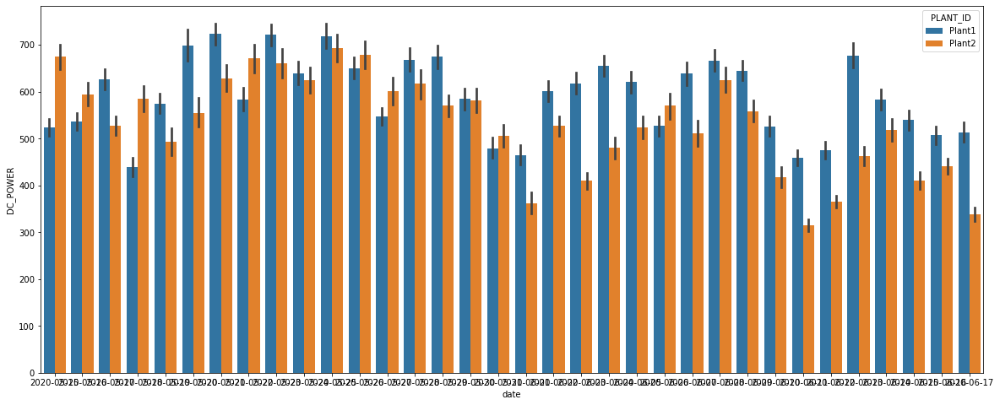

In [111]:
df_nozero_tmp['date'] = pd.to_datetime(df_nozero_tmp['DATE_TIME']).dt.date
sns.barplot(x = df_nozero_tmp.date, y = df_nozero_tmp.DC_POWER, hue = df_nozero_tmp.PLANT_ID)
fig = plt.gcf()
fig.set_size_inches(20, 8)

In [51]:
df_ALL_Eng = pd.DataFrame (df_nozero_tmp, columns = ['DATE_TIME', 'SK_INVERTERS', 'DC_POWER', 'AC_POWER', 'DAILY_YIELD',
       'TOTAL_YIELD', 'AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE',
       'IRRADIATION', 'PLANT_ID','EFFICIENCY'])
df_ALL_Eng.tail(10)


,DATE_TIME,SK_INVERTERS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,PLANT_ID,EFFICIENCY
136022,2020-06-17 18:45:00,V94E5Ben1TlhnDV,3.01,2.90,4324.00,1412292515.00,23.97,23.28,0.00,Plant2,H
136023,2020-06-17 18:45:00,WcxssY2VbP4hApt,3.54,3.42,4330.47,181911917.47,23.97,23.28,0.00,Plant2,H
136024,2020-06-17 18:45:00,mqwcsP2rE7J0TFp,3.67,3.54,4238.00,593815011.00,23.97,23.28,0.00,Plant2,L
136025,2020-06-17 18:45:00,oZ35aAeoifZaQzV,3.55,3.42,4467.00,1660188893.00,23.97,23.28,0.00,Plant2,H
136026,2020-06-17 18:45:00,oZZkBaNadn6DNKz,3.71,3.58,4388.71,1708287723.71,23.97,23.28,0.00,Plant2,H
136027,2020-06-17 18:45:00,q49J1IKaHRwDQnt,3.77,3.64,4156.86,520757.86,23.97,23.28,0.00,Plant2,L
136028,2020-06-17 18:45:00,rrq4fwE8jgrTyWY,2.86,2.76,3930.71,121131355.71,23.97,23.28,0.00,Plant2,L
136029,2020-06-17 18:45:00,vOuJvMaM2sgwLmb,3.78,3.63,4321.80,2427690.80,23.97,23.28,0.00,Plant2,H
136030,2020-06-17 18:45:00,xMbIugepa2P7lBB,3.58,3.45,4217.73,106896393.73,23.97,23.28,0.00,Plant2,L
136031,2020-06-17 18:45:00,xoJJ8DcxJEcupym,3.91,3.76,4315.64,209335740.64,23.97,23.28,0.00,Plant2,H


In [52]:
df_ALL_Eng['PLANT_ID'].value_counts()

Plant1    36685
Plant2    31907
Name: PLANT_ID, dtype: int64

In [53]:
df_ALL_Eng.loc[:,'POWER_RATIO'] = df_ALL_Eng['DC_POWER']/df_ALL_Eng['AC_POWER']*100
#df_ALL_Eng['EFFICIENCY'] = np.where(df_ALL_Eng['DC/AC_RATIO'] >= 1.25, 'LOW', 'HIGH')
#df_ALL_Eng['EFFICIENCY'] = np.where(df_ALL_Eng['DAILY_YIELD'] >= 4280, 'Yes', 'No')
df_ALL_Eng.head(100)

,DATE_TIME,SK_INVERTERS,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,PLANT_ID,EFFICIENCY,POWER_RATIO
531,2020-05-15 06:15:00,1BY6WEcLGh8j5v7,27.80,26.86,2.62,6259561.62,24.01,22.35,0.02,Plant1,L,103.49
532,2020-05-15 06:15:00,1IF53ai7Xc0U56Y,31.06,30.01,3.00,6183648.00,24.01,22.35,0.02,Plant1,L,103.47
533,2020-05-15 06:15:00,3PZuoBAID5Wc2HD,31.86,30.77,3.50,6987762.50,24.01,22.35,0.02,Plant1,L,103.53
534,2020-05-15 06:15:00,7JYdWkrLSPkdwr4,31.62,30.56,3.50,7602963.50,24.01,22.35,0.02,Plant1,L,103.48
535,2020-05-15 06:15:00,McdE0feGgRqW7Ca,31.14,30.10,3.14,7158967.14,24.01,22.35,0.02,Plant1,L,103.46
...,...,...,...,...,...,...,...,...,...,...,...,...
627,2020-05-15 07:15:00,ZoEaEvLYb1n2sOq,199.55,195.61,125.75,7098224.75,24.82,28.89,0.15,Plant1,L,102.01
628,2020-05-15 07:15:00,adLQvlD726eNBSB,214.37,210.17,134.14,6271489.14,24.82,28.89,0.15,Plant1,L,102.00
629,2020-05-15 07:15:00,bvBOhCH3iADSZry,187.35,183.65,116.25,6316919.25,24.82,28.89,0.15,Plant1,L,102.01
630,2020-05-15 07:15:00,iCRJl6heRkivqQ3,203.64,199.63,124.43,7178116.43,24.82,28.89,0.15,Plant1,L,102.01


In [54]:
df_ALL_Eng.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68592 entries, 531 to 136031
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            68592 non-null  datetime64[ns]
 1   SK_INVERTERS         68592 non-null  object        
 2   DC_POWER             68592 non-null  float64       
 3   AC_POWER             68592 non-null  float64       
 4   DAILY_YIELD          68592 non-null  float64       
 5   TOTAL_YIELD          68592 non-null  float64       
 6   AMBIENT_TEMPERATURE  68592 non-null  float64       
 7   MODULE_TEMPERATURE   68592 non-null  float64       
 8   IRRADIATION          68592 non-null  float64       
 9   PLANT_ID             68592 non-null  object        
 10  EFFICIENCY           68592 non-null  object        
 11  POWER_RATIO          68592 non-null  float64       
dtypes: datetime64[ns](1), float64(8), object(3)
memory usage: 9.3+ MB


In [55]:
df_ALL_Eng['POWER_RATIO'].value_counts()

103.70    18
103.45    18
103.70    14
103.57    12
103.33    11
          ..
102.15     1
102.56     1
102.31     1
101.96     1
103.14     1
Name: POWER_RATIO, Length: 67368, dtype: int64

In [79]:
column_names = ['DC_POWER', 'AC_POWER', 'AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE','IRRADIATION', 'POWER_RATIO', 'EFFICIENCY']
df_ALL_Eng2 = pd.DataFrame(df_ALL_Eng, columns=column_names)
column_names2 = ['DC_POWER', 'AC_POWER', 'DAILY_YIELD', 'AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE','IRRADIATION', 'PLANT_ID', 'POWER_RATIO']
df_ALL_Eng3 = pd.DataFrame(df_ALL_Eng, columns=column_names2)
display(df_ALL_Eng2)

,DC_POWER,AC_POWER,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,POWER_RATIO,EFFICIENCY
531,27.80,26.86,24.01,22.35,0.02,103.49,L
532,31.06,30.01,24.01,22.35,0.02,103.47,L
533,31.86,30.77,24.01,22.35,0.02,103.53,L
534,31.62,30.56,24.01,22.35,0.02,103.48,L
535,31.14,30.10,24.01,22.35,0.02,103.46,L
...,...,...,...,...,...,...,...
136027,3.77,3.64,23.97,23.28,0.00,103.73,L
136028,2.86,2.76,23.97,23.28,0.00,103.63,L
136029,3.78,3.63,23.97,23.28,0.00,104.04,H
136030,3.58,3.45,23.97,23.28,0.00,103.67,L


In [81]:
df_ALL_Eng2['EFFICIENCY'] = df_ALL_Eng2['EFFICIENCY'].astype('category')
#df_ALL_Eng2['PLANT_ID'] = df_ALL_Eng2['PLANT_ID'].astype('category')
df_ALL_Eng2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68592 entries, 531 to 136031
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   DC_POWER             68592 non-null  float64 
 1   AC_POWER             68592 non-null  float64 
 2   AMBIENT_TEMPERATURE  68592 non-null  float64 
 3   MODULE_TEMPERATURE   68592 non-null  float64 
 4   IRRADIATION          68592 non-null  float64 
 5   POWER_RATIO          68592 non-null  float64 
 6   EFFICIENCY           68592 non-null  category
dtypes: category(1), float64(6)
memory usage: 6.2 MB


In [82]:
df_ALL_Eng2.describe()

,DC_POWER,AC_POWER,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,POWER_RATIO
count,68592.00,68592.00,68592.00,68592.00,68592.00,68592.00
mean,559.01,546.70,28.67,39.29,0.42,102.35
std,381.80,372.73,3.76,10.80,0.29,0.50
min,0.47,0.45,20.43,18.25,0.00,93.82
25%,203.56,199.54,25.93,30.17,0.15,102.02
50%,539.94,529.33,28.26,38.87,0.39,102.20
75%,861.85,842.88,31.27,48.02,0.64,102.51
max,1447.11,1410.95,39.18,66.64,1.22,109.55


<AxesSubplot:xlabel='EFFICIENCY', ylabel='count'>

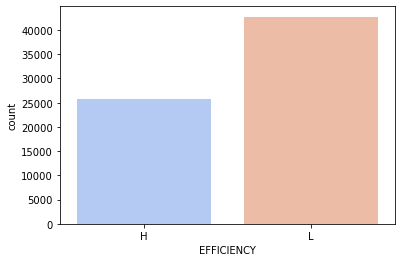

In [83]:
sns.countplot(x='EFFICIENCY', data=df_ALL_Eng2, palette='coolwarm')

**Processing Features**

**How comparable is our overall efficiency for both plants?**

In [84]:
df_ALL_Eng2['EFFICIENCY'].value_counts()

L    42752
H    25840
Name: EFFICIENCY, dtype: int64

In [85]:
df_ALL_Eng2['EFFICIENCY'].unique()

['L', 'H']
Categories (2, object): ['L', 'H']

In [86]:
from sklearn.model_selection import train_test_split

In [87]:
df_ALL_Eng3['DAILY_YIELD'].unique()

array([2.62500000e+00, 3.00000000e+00, 3.50000000e+00, ...,
       4.32180000e+03, 4.21773333e+03, 4.31564286e+03])

In [88]:
df_train, df_test = train_test_split(df_ALL_Eng2, test_size=0.2)
import sklearn.preprocessing

In [89]:
df_ALL_Eng2.head(5)

,DC_POWER,AC_POWER,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,POWER_RATIO,EFFICIENCY
531,27.80,26.86,24.01,22.35,0.02,103.49,L
532,31.06,30.01,24.01,22.35,0.02,103.47,L
533,31.86,30.77,24.01,22.35,0.02,103.53,L
534,31.62,30.56,24.01,22.35,0.02,103.48,L
535,31.14,30.10,24.01,22.35,0.02,103.46,L


###Train Data Standartization

In [90]:
x_DC_POWER = df_train.loc[:,('DC_POWER')].values
x_DC_POWER = x_DC_POWER.reshape(-1, 1)
DC_POWER_scaler = sklearn.preprocessing.StandardScaler()
x_DC_POWER_scaled = DC_POWER_scaler.fit_transform(x_DC_POWER)

x_AC_POWER = df_train.loc[:,('AC_POWER')].values
x_AC_POWER = x_AC_POWER.reshape(-1, 1)
AC_POWER_scaler = sklearn.preprocessing.StandardScaler()
x_AC_POWER_scaled = AC_POWER_scaler.fit_transform(x_AC_POWER)

x_IRRAD = df_train.loc[:,('IRRADIATION')].values
x_IRRAD = x_IRRAD.reshape(-1, 1)
IRRAD_scaler = sklearn.preprocessing.StandardScaler()
x_IRRAD_scaled = IRRAD_scaler.fit_transform(x_IRRAD)

x_ATEMP = df_train.loc[:,('AMBIENT_TEMPERATURE')].values
x_ATEMP = x_ATEMP.reshape(-1, 1)
ATEMP_scaler = sklearn.preprocessing.StandardScaler()
x_ATEMP_scaled = ATEMP_scaler.fit_transform(x_ATEMP)

x_MTEMP = df_train.loc[:,('MODULE_TEMPERATURE')].values
x_MTEMP = x_MTEMP.reshape(-1, 1)
MTEMP_scaler = sklearn.preprocessing.StandardScaler()
x_MTEMP_scaled = MTEMP_scaler.fit_transform(x_MTEMP)


###Test Data Standartization

In [91]:
x_DC_POWER_test = df_test.loc[:,('DC_POWER')].values
x_DC_POWER_test = x_DC_POWER_test.reshape(-1, 1)
x_DC_POWER_test_scaled = DC_POWER_scaler.fit_transform(x_DC_POWER_test)

x_AC_POWER_test = df_test.loc[:,('AC_POWER')].values
x_AC_POWER_test = x_AC_POWER_test.reshape(-1, 1)
x_AC_POWER_test_scaled = AC_POWER_scaler.fit_transform(x_AC_POWER_test)

x_IRRAD_test = df_test.loc[:,('IRRADIATION')].values
x_IRRAD_test = x_IRRAD_test.reshape(-1, 1)
x_IRRAD_test_scaled = IRRAD_scaler.fit_transform(x_IRRAD_test)

x_ATEMP_test = df_test.loc[:,('AMBIENT_TEMPERATURE')].values
x_ATEMP_test = x_ATEMP_test.reshape(-1, 1)
x_ATEMP_test_scaled = ATEMP_scaler.fit_transform(x_ATEMP_test)

x_MTEMP_test = df_test.loc[:,('MODULE_TEMPERATURE')].values
x_MTEMP_test = x_MTEMP_test.reshape(-1, 1)
x_MTEMP_test_scaled = MTEMP_scaler.fit_transform(x_MTEMP_test)

###Train Data Normalization


In [92]:
DC_POWER_minmax = sklearn.preprocessing.MinMaxScaler()
x_DC_POWER_minmax = DC_POWER_minmax.fit_transform(x_DC_POWER)

AC_POWER_minmax = sklearn.preprocessing.MinMaxScaler()
x_AC_POWER_minmax = AC_POWER_minmax.fit_transform(x_AC_POWER)

IRRAD_minmax = sklearn.preprocessing.MinMaxScaler()
x_IRRAD_minmax = IRRAD_scaler.fit_transform(x_IRRAD)

ATEMP_minmax = sklearn.preprocessing.MinMaxScaler()
x_ATEMP_minmax = ATEMP_minmax.fit_transform(x_ATEMP)

MTEMP_minmax = sklearn.preprocessing.MinMaxScaler()
x_MTEMP_minmax = MTEMP_minmax.fit_transform(x_MTEMP)

###Test Data Normalization

In [93]:
x_DC_POWER_test_minmax = DC_POWER_minmax.fit_transform(x_DC_POWER_test)
x_AC_POWER_test_minmax = AC_POWER_minmax.fit_transform(x_AC_POWER_test)
x_IRRAD_test_minmax = IRRAD_minmax.fit_transform(x_IRRAD_test)
x_ATEMP_test_minmax = ATEMP_minmax.fit_transform(x_ATEMP_test)
x_MTEMP_test_minmax = MTEMP_minmax.fit_transform(x_MTEMP_test)

###Visual Comparison Examples

In [94]:
DC_POWER_dict = {'standardization': x_DC_POWER_scaled.flatten() , 'normalization': x_DC_POWER_minmax.flatten() }
# have to flatten the list because it came with index

df_DC_POWER = pd.DataFrame.from_dict(DC_POWER_dict)
df_DC_POWER = df_DC_POWER.melt()

fig = px.box(df_DC_POWER, y="value", facet_col="variable", boxmode="overlay", color="variable")

for i in range(len(fig["data"])):
    yaxis_name = 'yaxis' if i == 0 else f'yaxis{i + 1}'
    fig.layout[yaxis_name].showticklabels = True

fig.update_layout(legend = dict(bgcolor = 'white'))
fig.update_layout(plot_bgcolor='white')

fig.update_xaxes(showline=True, linewidth=2, linecolor='black')#, mirror=True)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black')#, mirror=True)

fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='gray')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='gray')

fig.show()

In [95]:
IRRAD_dict = {'standardization': x_IRRAD_scaled.flatten() , 'normalization': x_IRRAD_minmax.flatten() }
# have to flatten the list because it came with index

df_IRRAD = pd.DataFrame.from_dict(IRRAD_dict)
df_IRRAD = df_IRRAD.melt()

fig = px.box(df_IRRAD, y="value", facet_col="variable", boxmode="overlay", color="variable")

for i in range(len(fig["data"])):
    yaxis_name = 'yaxis' if i == 0 else f'yaxis{i + 1}'
    fig.layout[yaxis_name].showticklabels = True

fig.update_layout(legend = dict(bgcolor = 'white'))
fig.update_layout(plot_bgcolor='white')

fig.update_xaxes(showline=True, linewidth=2, linecolor='black')#, mirror=True)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black')#, mirror=True)

fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='gray')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='gray')

fig.show()

##KNN Model

In [96]:
from sklearn.neighbors import KNeighborsClassifier 

###Split features and target

In [97]:
KNN_features = df_ALL_Eng2.drop('EFFICIENCY', axis=1)
#KNN_features = df_ALL_Eng2.drop('PLANT_ID', axis=1)
KNN_features_test = df_ALL_Eng2.drop('EFFICIENCY', axis=1)
#KNN_features_test = df_ALL_Eng2.drop('PLANT_ID', axis=1)
target = df_ALL_Eng2['EFFICIENCY']

In [98]:
df_ALL_Eng2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 68592 entries, 531 to 136031
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   DC_POWER             68592 non-null  float64 
 1   AC_POWER             68592 non-null  float64 
 2   AMBIENT_TEMPERATURE  68592 non-null  float64 
 3   MODULE_TEMPERATURE   68592 non-null  float64 
 4   IRRADIATION          68592 non-null  float64 
 5   POWER_RATIO          68592 non-null  float64 
 6   EFFICIENCY           68592 non-null  category
dtypes: category(1), float64(6)
memory usage: 6.2 MB


###Split train and test data

In [99]:
from sklearn.model_selection import train_test_split
X = KNN_features
y = target
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.33, random_state=42)

###Create a model instance with n_neighbors=5

In [100]:
knn = KNeighborsClassifier(n_neighbors=5)

###Fit the model

In [101]:
knn.fit(X_train, y_train)

KNeighborsClassifier()

###Predictions for the test data

In [102]:
predictions_test = knn.predict(X_test)
predictions_train = knn.predict(X_train)

###Print confusion matrix and classification report

In [103]:
from sklearn.metrics import classification_report,confusion_matrix
print(confusion_matrix(y_test, predictions_test))
print(classification_report(y_test,predictions_test))

[[ 5936  2555]
 [ 2476 11669]]
              precision    recall  f1-score   support

           H       0.71      0.70      0.70      8491
           L       0.82      0.82      0.82     14145

    accuracy                           0.78     22636
   macro avg       0.76      0.76      0.76     22636
weighted avg       0.78      0.78      0.78     22636



In [104]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test, predictions_test)

0.7777434175649408

In [105]:
print(confusion_matrix(y_test, predictions_test))
print(classification_report(y_train,predictions_train))

[[ 5936  2555]
 [ 2476 11669]]
              precision    recall  f1-score   support

           H       0.80      0.79      0.80     17349
           L       0.88      0.88      0.88     28607

    accuracy                           0.85     45956
   macro avg       0.84      0.84      0.84     45956
weighted avg       0.85      0.85      0.85     45956



In [106]:
accuracy_score(y_train, predictions_train)

0.8472669509966054

In [107]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

In [108]:
display(precision_score(y_train, predictions_train, average="binary", pos_label="H"))
display(precision_score(y_test, predictions_test, average="binary", pos_label="H"))

0.7993855784836541

0.7056585829766999

In [109]:
display(recall_score(y_train, predictions_train, average="binary", pos_label="L"))
display(recall_score(y_test, predictions_test, average="binary", pos_label="L"))

0.879015625546195

0.824955814775539

In [110]:
err_rate = []

for i in range(1,100):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,y_train)
    prediction_i = knn.predict(X_test)
    err_rate.append(np.mean(prediction_i != y_test))

In [ ]:
plt.figure(figsize=(16,6))
plt.plot(range(1,100),err_rate,color='green', 
         marker='o',markerfacecolor='blue')
plt.title('Error Rate vs. K Value')
plt.xlabel('K_Value')
plt.ylabel('Error_Rate')

##The Decision Tree Model

###Encoding and preprocessing

In [ ]:
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OrdinalEncoder, LabelEncoder

In [ ]:
DT_features = column_names[:-1]
DT_label = column_names[-1]
X_preprocess = make_column_transformer((OrdinalEncoder(), DT_features), remainder='drop')
y_preprocess = LabelEncoder()

In [ ]:
X = X_preprocess.fit_transform(df_ALL_Eng2[DT_features])
y = y_preprocess.fit_transform(df_ALL_Eng2[DT_label])

In [ ]:
df_encode = df_ALL_Eng2.copy()
df_encode[DT_features] = X
df_encode[DT_label] = y


In [ ]:
df_train, df_test = train_test_split(df_encode, test_size=0.2)

In [ ]:
X_train = df_train.iloc[:, :-1]
y_train = df_train['EFFICIENCY']

X_test = df_test.iloc[:, :-1]
y_test = df_test['EFFICIENCY']

###GINI Index

In [ ]:
from sklearn.tree import DecisionTreeClassifier
import graphviz
from sklearn.tree import export_graphviz

dtree = DecisionTreeClassifier()
dtree.fit(X_train, y_train)

In [ ]:
prediction_train = dtree.predict(X_train)
prediction_test = dtree.predict(X_test)

In [ ]:
print("On train data: Efficiency")
print(classification_report(y_train, prediction_train, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_train, prediction_train))
print("On test data: Efficiency")
print(classification_report(y_test, prediction_test, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_test, prediction_test))

In [ ]:
dot_data = export_graphviz(dtree, out_file=None, filled=True, rounded=True, rotate=True)  
display(graphviz.Source(dot_data))

In [ ]:
from sklearn.metrics import classification_report, plot_confusion_matrix
print("Test data:")
plot_confusion_matrix(dtree, X_test, y_test)

###Entropy

In [ ]:
dtree_ent = DecisionTreeClassifier(criterion='entropy')
dtree_ent.fit(X_train, y_train)

predict_ent_train = dtree_ent.predict(X_train)
predict_ent_test = dtree_ent.predict(X_test)

In [ ]:
print("On train data: Efficiency")
print(classification_report(y_train, predict_ent_train, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_train, predict_ent_train))
print("On test data: Efficiency")
print(classification_report(y_test, predict_ent_test, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_test, predict_ent_test))

###Entropy with random splitter

In [ ]:
dtree_ran = DecisionTreeClassifier(splitter='random', criterion='entropy')
dtree_ran.fit(X_train, y_train)

predict_ran_train = dtree_ran.predict(X_train)
predict_ran_test = dtree_ran.predict(X_test)

In [ ]:
print("On train data: Efficiency")
print(classification_report(y_train, predict_ran_train, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_train, predict_ran_train))
print("On test data: Efficiency")
print(classification_report(y_test, predict_ran_test, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_test, predict_ran_test))

###Entropy with random splitter and min_sample_split

In [ ]:
dtree_sam = DecisionTreeClassifier(splitter='random', criterion='entropy', min_samples_split=2)
dtree_sam.fit(X_train, y_train)

predict_sam_train = dtree_sam.predict(X_train)
predict_sam_test = dtree_sam.predict(X_test)

In [ ]:
print("On train data: Efficiency")
print(classification_report(y_train, predict_sam_train, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_train, predict_sam_train))
print("On test data: Efficiency")
print(classification_report(y_test, predict_sam_test, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_test, predict_sam_test))

###Entropy with random splitter, min_sample_split and min_sample_leaf

In [ ]:
dtree_leaf = DecisionTreeClassifier(splitter='random', criterion='entropy', min_samples_split=2, min_samples_leaf=2)
dtree_leaf.fit(X_train, y_train)

predict_leaf_train = dtree_leaf.predict(X_train)
predict_leaf_test = dtree_leaf.predict(X_test)

In [ ]:
print("On train data: Efficiency")
print(classification_report(y_train, predict_leaf_train, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_train, predict_leaf_train))
print("On test data: Efficiency")
print(classification_report(y_test, predict_leaf_test, \
                           target_names=['No', 'Yes']))
print(confusion_matrix(y_test, predict_leaf_test))

###Max Depth

In [ ]:
dtree.get_n_leaves()

In [ ]:
dtree.get_depth()

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
hyperparameter_grid = {
    'max_depth':             np.arange(1, 30)
#    'min_samples_split':     np.arange(2, 20),
#    'min_samples_leaf':      np.arange(1, 10),
#    'max_leaf_nodes':        np.arange(1, 140, 5),
#    'min_impurity_decrease': np.logspace(-1, -100, 11),
#    'min_impurity_split':    np.logspace(-1, -100, 11)
}

scoring = 'accuracy'
scoring_name = 'Accuracy'

In [ ]:
search = GridSearchCV(DecisionTreeClassifier(), hyperparameter_grid, scoring, n_jobs=-1, cv=10)
search.fit(X_train, y_train)

In [ ]:
search.cv_results_

In [ ]:
means = search.cv_results_['mean_test_score']
stds = search.cv_results_['std_test_score']

x_axis = hyperparameter_grid['max_depth']
x_axis_name = 'Max depth'

In [ ]:
import plotly.graph_objects as go

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=x_axis, 
                        y=means,
                        mode='lines',
                        name='Training',
                        line=dict(color='red'),
                        showlegend=False))
fig.add_trace(go.Scatter(x=x_axis, 
                        y=means - stds,
                        mode='lines',
                        name='Training lower bound',
                        line=dict(width=0, color='red'),
                        showlegend=False))
fig.add_trace(go.Scatter(x=x_axis, 
                        y=means + stds,
                        mode='lines',
                        name='Training upper bound',
                        line=dict(width=0, color='red'),
                        fill='tonexty',
                        fillcolor='rgba(255, 0, 0, 0.3)',
                        showlegend=False))

fig.update_layout(title='Grid search for hyperparameter tuning',
                 xaxis_title=x_axis_name,
                 yaxis_title=scoring_name)
fig.show()

###Max_leaf_nodes

In [ ]:
hyperparameter_grid = {
    # 'max_depth':             np.arange(1, 14),
#    'min_samples_split':     np.arange(2, 20),
#    'min_samples_leaf':      np.arange(1, 10),
   'max_leaf_nodes':        np.arange(1, 2600, 200),
#    'min_impurity_decrease': np.logspace(-1, -100, 11),
#    'min_impurity_split':    np.logspace(-1, -100, 11)
}

scoring = 'accuracy'
scoring_name = 'Accuracy'

In [ ]:
search = GridSearchCV(DecisionTreeClassifier(), 
                      hyperparameter_grid, 
                      scoring,
                      n_jobs=-1,
                      cv=10)

search.fit(X_train, y_train)

In [ ]:
search.cv_results_

In [ ]:
means = search.cv_results_['mean_test_score']
stds = search.cv_results_['std_test_score']

x_axis = hyperparameter_grid['max_leaf_nodes']
x_axis_name = 'Max Leaf Nodes'

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=x_axis, 
                        y=means,
                        mode='lines',
                        name='Training',
                        line=dict(color='red'),
                        showlegend=False))
fig.add_trace(go.Scatter(x=x_axis, 
                        y=means - stds,
                        mode='lines',
                        name='Training lower bound',
                        line=dict(width=0, color='red'),
                        showlegend=False))
fig.add_trace(go.Scatter(x=x_axis, 
                        y=means + stds,
                        mode='lines',
                        name='Training upper bound',
                        line=dict(width=0, color='red'),
                        fill='tonexty',
                        fillcolor='rgba(255, 0, 0, 0.3)',
                        showlegend=False))

fig.update_layout(title='Grid search for hyperparameter tuning',
                 xaxis_title=x_axis_name,
                 yaxis_title=scoring_name)
fig.show()

###Post Pruning

In [ ]:
hyperparameter_grid = {
    'ccp_alpha': np.linspace(0.0, 0.2, 101),
}

scoring = 'accuracy'
scoring_name = 'Accuracy'

In [ ]:
search = GridSearchCV(DecisionTreeClassifier(), 
                      hyperparameter_grid, 
                      scoring,
                      n_jobs=-1,
                      cv=10)

search.fit(X_train, y_train)

In [ ]:
means = search.cv_results_['mean_test_score']
stds = search.cv_results_['std_test_score']

x_axis = hyperparameter_grid['ccp_alpha']
x_axis_name = 'Cost complexity pruning effective alpha'

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=x_axis, 
                        y=means,
                        mode='lines',
                        name='Training',
                        line=dict(color='red'),
                        showlegend=False))
fig.add_trace(go.Scatter(x=x_axis, 
                        y=means - stds,
                        mode='lines',
                        name='Training lower bound',
                        line=dict(width=0, color='red'),
                        showlegend=False))
fig.add_trace(go.Scatter(x=x_axis, 
                        y=means + stds,
                        mode='lines',
                        name='Training upper bound',
                        line=dict(width=0, color='red'),
                        fill='tonexty',
                        fillcolor='rgba(255, 0, 0, 0.3)',
                        showlegend=False))

fig.update_layout(title='Grid search for hyperparameter tuning',
                 xaxis_title=x_axis_name,
                 yaxis_title=scoring_name)
fig.show()

##Random Forest Model

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=200)

In [ ]:
rfc.fit(X_train, y_train)

In [ ]:
rfc_predictions = rfc.predict(X_test)

In [ ]:
print(classification_report(y_test,rfc_predictions))
print(confusion_matrix(y_test,rfc_predictions))

##Linear Regression Model

X, y arrays and Train Test Split

In [ ]:
df_ALL_Eng3.head()

In [ ]:
df_ALL_Eng3.info()

In [ ]:
df_ALL_Eng3['PLANT_ID'] = df_ALL_Eng3['PLANT_ID'].astype('float64')

In [ ]:
df_ALL_Eng3.shape

In [ ]:
X = df_ALL_Eng3.drop('DAILY_YIELD', axis = 1)
y = df_ALL_Eng3['DAILY_YIELD']
y

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

Creating and Training the Model including all features

In [ ]:
from sklearn import linear_model

In [ ]:
lm = linear_model.LinearRegression()

In [ ]:
lm.fit(X_train,y_train)

Model Evaluation

In [ ]:
print(lm.intercept_)

In [ ]:
coeff_df = pd.DataFrame(lm.coef_,X.columns,columns=['Coefficient'])
coeff_df

Prediction based on all features

In [ ]:
predictions = lm.predict(X_test)

In [ ]:
plt.scatter(y_test, predictions)

In [ ]:
sns.distplot((y_test-predictions),bins=50);

In [ ]:
from sklearn import metrics
print('MAE:', metrics.mean_absolute_error(y_test, predictions))
print('MSE:', metrics.mean_squared_error(y_test, predictions))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predictions)))
print('R2:', metrics.r2_score(y_test, predictions))

###Losses

In [ ]:
LinR_features = ['DC_POWER', 'AC_POWER', 'AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE','IRRADIATION', 'PLANT_ID', 'POWER_RATIO']
LinR_label = ['DAILY_YIELD']

In [ ]:
X = df_ALL_Eng3[LinR_features].to_numpy()
y = df_ALL_Eng3[LinR_label].to_numpy()
df_encode = df_ALL_Eng2.copy()
df_encode[LinR_features] = X
df_encode[LinR_label] = y

In [ ]:
df_ALL_Eng3.head()

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

In [ ]:
df_train, df_test = train_test_split(df_ALL_Eng3, test_size=0.2)

In [ ]:
X_train = df_train[LinR_features]
y_train = df_train[Lin_label]

X_test = df_test[LinR_features]
y_test = df_test[Lin_label]

In [ ]:
linear_regressor = LinearRegression()

linear_regressor.fit(X, y)

print("b : ", linear_regressor.intercept_[0])
print("w :", linear_regressor.coef_)

In [ ]:
m = y.shape[0]

X_ATemp = X[:, 2]
X_ATemp = X_ATemp.reshape(-1, 1)
linear_regressor_ATemp = LinearRegression()
linear_regressor_ATemp.fit(X_ATemp, y)
pred_ATemp = linear_regressor_ATemp.predict(X_ATemp)
error1 = pred_ATemp - y

X_MTemp = X[:, 3]
X_MTemp = X_MTemp.reshape(-1, 1)
linear_regressor_MTemp = LinearRegression()
linear_regressor_MTemp.fit(X_MTemp, y)
pred_MTemp = linear_regressor_MTemp.predict(X_MTemp)
error2 = pred_MTemp - y

X_IRRAD = X[:, 4]
X_IRRAD = X_IRRAD.reshape(-1, 1)
linear_regressor_IRRAD = LinearRegression()
linear_regressor_IRRAD.fit(X_IRRAD, y)
pred_IRRAD = linear_regressor_IRRAD.predict(X_IRRAD)
error3 = pred_IRRAD - y

In [ ]:
# DC_Power - AC_Power - ambient temperature - module temperature - irradiation - power_ratio
X[:, 0], X[:, 1],X[:, 2], X[:, 3], X[:, 4], X[:, 6]

In [ ]:
# average L1 loss for the left hypothesis
average_loss1_L1 = (1 / m) * np.linalg.norm(error1, ord=1)
# average L1 loss for the centre hypothesis
average_loss2_L1 = (1 / m) * np.linalg.norm(error2, ord=1)
# average L1 loss for the right hypothesis
average_loss3_L1 = (1 / m) * np.linalg.norm(error3, ord=1)

# average L2-squared loss for the left hypothesis
average_loss1_L2 = (1 / m) * (np.linalg.norm(error1, ord=2) ** 2)
# average L2-squared loss for the centre hypothesis
average_loss2_L2 = (1 / m) * (np.linalg.norm(error2, ord=2) ** 2)
# average L2-squared loss for the right hypothesis
average_loss3_L2 = (1 / m) * (np.linalg.norm(error3, ord=2) ** 2)

def L_inf(v):
  return np.max(v)

# L-infinity loss for the left hypothesis
loss1_Li = L_inf(error1)
# L-infinity loss for the centre hypothesis
loss2_Li = L_inf(error2)
# L-infinity loss for the right hypothesis
loss3_Li = L_inf(error3)

losses_list = [[average_loss1_L1, average_loss2_L1, average_loss3_L1],
               [average_loss1_L2, average_loss2_L2, average_loss3_L2],
               [        loss1_Li,         loss2_Li,         loss3_Li]]
row_names = ["Average L1 Loss", "Average L2-Squared Loss", "L-Infinity Loss"]               
column_names = ["Left Hypothesis", "Centre Hypothesis", "Right Hypothesis"]
display(pd.DataFrame(losses_list, index=row_names, columns=column_names))

In [ ]:
W = np.array([0.0, linear_regressor.coef_[0, 1], linear_regressor.coef_[0, 6]] )
b = linear_regressor.intercept_[0]

x_vis_1_range = np.linspace(X[:,1].min(), X[:,1].max(), 100 )
x_vis_2_range = np.linspace(X[:,6].min(), X[:,6].max(), 100 )

XX_vis_1, XX_vis_2 = np.meshgrid(x_vis_1_range, x_vis_2_range)
X_vis = np.c_[XX_vis_1.flatten(), XX_vis_2.flatten()]
grid_shape = XX_vis_1.shape
column_shape = XX_vis_1.flatten().shape
X_vis_b = np.c_[np.ones(column_shape), X_vis]

y_vis = X_vis_b @ W + b
YY_vis = y_vis.reshape(grid_shape)

fig = go.Figure()

fig.add_trace(go.Scatter3d(x=X[:, 1],
                          y=X[:, 6],
                          z=y[:, 0],
                          mode='markers',
                          marker=dict(colorscale='Teal',
                                      opacity=0.75
                                     )
                         )
            )
fig.add_trace(go.Surface(x=x_vis_1_range,
                        y=x_vis_2_range,
                        z=YY_vis, 
                        showscale=False
                       )
            )

fig.update_layout(scene=dict(xaxis_title="x_1",
                            yaxis_title="x_2",
                            zaxis_title="y"
                           ),
                 showlegend=False
                )

fig.show()

In [ ]:
m = X_ATemp.shape[0]
n = X_ATemp.shape[1]

print("X =")
display(X_ATemp)
print("y =")
display(y)
print("m =", m)
print("n =", n)

In [ ]:
M = np.eye(m) - (1 / m)

w = np.linalg.solve(X.T @ M @ X, X.T @ M @ y)
b = np.average(y - (X @ w))

print("b =")
display(b)
print("w =")
display(w)

In [ ]:
X_b = np.c_[np.ones((m, 1)), X]

n_b = n + 1

w_b = np.linalg.solve(X_b.T @ X_b, X_b.T @ y)

print("w_b =")
display(w_b)

b_recovered = w_b[0]
w_recovered = w_b[1:]

print("recovered b =")
display(b_recovered)
print("recovered w =")
display(w_recovered)

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=X_b[:, 1], 
                        y=y[:, 0], 
                        mode='markers',
                        name="Datapoints"))

x_mins = np.min(X_b, axis=0)[:, None]
x_maxs = np.max(X_b, axis=0)[:, None]
X_vis = np.r_[x_mins.T, x_maxs.T]
y_vis = X_vis @ w_b

fig.add_trace(go.Scatter(x=X_vis[:, 1], 
                        y=y_vis[:, 0],
                        mode='lines',
                        name="Regression line"))

fig.show()

###Gradient Descent

In [ ]:
# Building the model
#m = 0
#c = 0

#L = 0.0001  # The learning Rate
#epochs = 3   # The number of iterations to perform gradient descent

#n = float(len(X)) # Number of elements in X

# Performing Gradient Descent 
#for i in range(epochs): 
#    Y_pred = m*X + c  # The current predicted value of Y
#    D_m = (-2/n) * sum(X * (y - Y_pred))  # Derivative wrt m
#    D_c = (-2/n) * sum(y - Y_pred)  # Derivative wrt c
#    m = m - L * D_m  # Update m
#    c = c - L * D_c  # Update c
    
#print (m, c)

In [ ]:
#Y_pred = m*X + c

#plt.scatter(X, Y) 
#plt.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='red')  # regression line
#plt.show()

##Logistic Regression Model

In [ ]:
X = df_ALL_Eng2.drop('EFFICIENCY', axis = 1)
y = df_ALL_Eng2['EFFICIENCY']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.30, random_state=42)

In [ ]:
from sklearn.linear_model import LogisticRegression
logReg = LogisticRegression()

In [ ]:
logReg.fit(X_train,y_train)

In [ ]:
m = X.shape[0]
n = X.shape[1]

In [ ]:
X_b = np.c_[np.ones((m, 1)), X]
n_b = n + 1

In [ ]:
tolerance = 0.01 # the desired level of precision to stop at
alpha = 0.1 # step size (or learning rate)

In [ ]:
np.random.seed(42) # for experiment control purposes
w_b_0 = np.random.normal(0.0, 1.0, (n_b, 1))
w_b = w_b_0
w_b

In [ ]:
#predict = X_b @ w_b
#y_diff = predict - y
#loss = (y_diff.T @ y_diff)[0, 0] / m

In [ ]:
lg_predict = logReg.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test,lg_predict))
from sklearn.metrics import confusion_matrix
print(confusion_matrix(y_test, lg_predict))